In [1]:
import torch

# Check if CUDA (NVIDIA GPU) is available
if torch.cuda.is_available():
    print("GPU is available.")
    print("GPU name: ", torch.cuda.get_device_name(0))
else:
    print("No GPU found.")

GPU is available.
GPU name:  NVIDIA GeForce RTX 3060


In [5]:
!pip install -U ultralytics
!pip install supervision

   ---------------------------------------- 0.0/896.9 kB ? eta -:--:--
   ---------------------------------------- 896.9/896.9 kB 4.5 MB/s eta 0:00:00
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.3.38
    Uninstalling ultralytics-8.3.38:
      Successfully uninstalled ultralytics-8.3.38


In [1]:
#import neccessary libraries
import shutil
from pathlib import Path
import sys

from matplotlib import pyplot as plt
import skimage.io as io
from torch import cuda
import supervision as sv
from ultralytics import YOLO

import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [2]:
print(sys.version)
import torch

has_gpu = cuda.is_available()
device = torch.device('cuda' if has_gpu else 'cpu')

print(device)
if has_gpu:
    print(cuda.get_device_name(0))
    

3.10.14 | packaged by conda-forge | (main, Mar 20 2024, 12:40:08) [MSC v.1938 64 bit (AMD64)]
cuda
NVIDIA GeForce RTX 3060


In [4]:

#model trained on lab computer with kaggle dataset
model_path = "/Users/Spenc/yoloV11/model/modelweights/weights/best.pt"

model = YOLO(model_path)  # Pretrained model


layer_count = len(list(model.model.modules()))
print(f"The YOLO model has {layer_count} layers.")


The YOLO model has 409 layers.


In [ ]:
#training the model
model.train(
    data="/Users/Spenc/yoloV11/dataset/data.yaml",        # Path to dataset YAML
    epochs=300,                 # Number of training epochs
    patience=30,                # Early stopping patience
    imgsz=512,                  # Image size
    batch=32,                   # Batch size
    iou=0.5,                    # IoU threshold for validation
    freeze=20,                 # Freeze early layers for transfer learning
    workers=0,    # Set the number of workers for data loading, I was getting an error for some strange reason, after some research this fixed it
)

In [16]:
#these weights are from training on leonardo ai images i.e: our best performing model thus far
model = YOLO("/Users/Spenc/yoloV11/runs/detect/train19/weights/best.pt")

# Run predictions on the test set for visual inspection
model.predict(
    source="/Users/Spenc/yoloV11/dataset/test/images",
    imgsz=640,
    conf=0.40,
    save=True
)


image 1/10 C:\Users\Spenc\yoloV11\dataset\test\images\Leonardo_Phoenix_Photo_of_brushed_sand_mostly_flat_ground_but_0-2-_jpg.rf.3c3e0d42b625e96a1bfef9941553b2dc.jpg: 384x640 6 holes, 7 rocks, 11.0ms
image 2/10 C:\Users\Spenc\yoloV11\dataset\test\images\Leonardo_Phoenix_Photo_of_brushed_sand_mostly_flat_ground_but_1-4_jpg.rf.f39eacd1c68b3bce6b54c1a011b0f9c8.jpg: 384x640 3 holes, 11 rocks, 16.0ms
image 3/10 C:\Users\Spenc\yoloV11\dataset\test\images\image141_jpg.rf.f102138518cbd920ac9d1f790ff402ea.jpg: 384x640 3 holes, 24 rocks, 5.2ms
image 4/10 C:\Users\Spenc\yoloV11\dataset\test\images\image178_jpg.rf.18bb12ed7f0e011ebdcce5a560a740f9.jpg: 384x640 13 holes, 27 rocks, 20.4ms
image 5/10 C:\Users\Spenc\yoloV11\dataset\test\images\image206_jpg.rf.84ae25e1326030e3812d354732884144.jpg: 384x640 3 holes, 15 rocks, 16.4ms
image 6/10 C:\Users\Spenc\yoloV11\dataset\test\images\image228_jpg.rf.7f00e574c7d80283b9d9ef82ce8faf82.jpg: 384x640 9 holes, 13 rocks, 8.9ms
image 7/10 C:\Users\Spenc\yoloV11\

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'hole', 1: 'r-', 2: 'rock'}
 obb: None
 orig_img: array([[[28, 22,  0],
         [28, 22,  0],
         [28, 21,  1],
         ...,
         [73, 74, 70],
         [72, 73, 69],
         [70, 71, 67]],
 
        [[28, 22,  0],
         [28, 22,  0],
         [28, 21,  1],
         ...,
         [73, 74, 70],
         [70, 71, 67],
         [68, 69, 65]],
 
        [[28, 21,  1],
         [28, 21,  1],
         [28, 21,  2],
         ...,
         [73, 74, 70],
         [69, 70, 66],
         [66, 67, 63]],
 
        ...,
 
        [[34, 23,  9],
         [34, 23,  9],
         [31, 23,  6],
         ...,
         [78, 79, 75],
         [76, 77, 73],
         [74, 75, 71]],
 
        [[34, 23,  9],
         [34, 23,  9],
         [31, 23,  6],
         ...,
         [80, 81, 77],
         [76, 77, 73],
         [74, 75, 71]],
 
        [

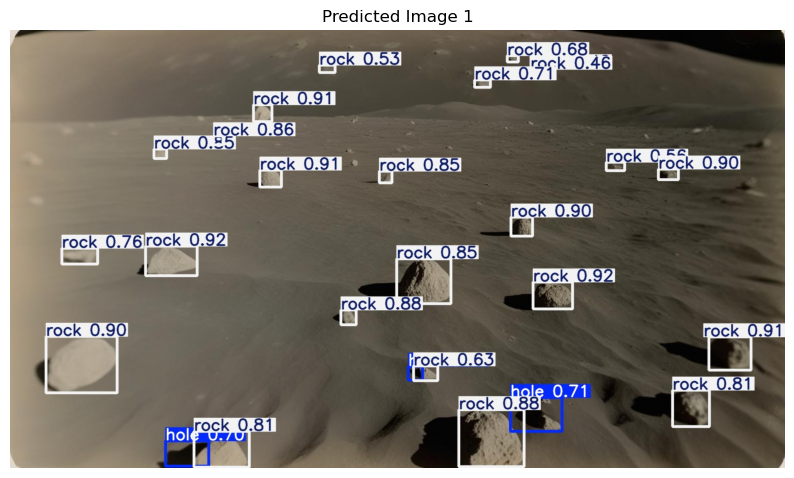

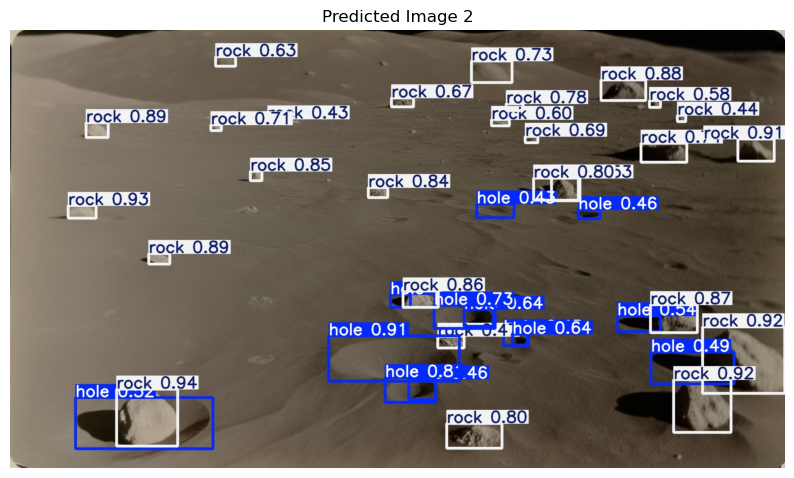

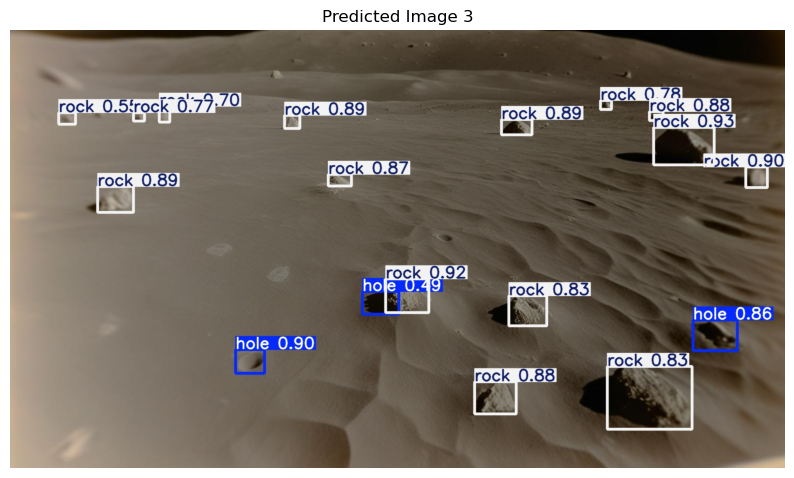

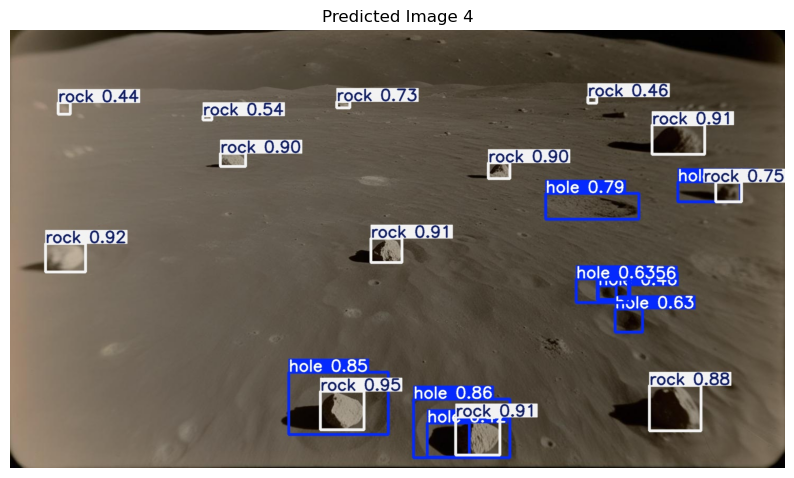

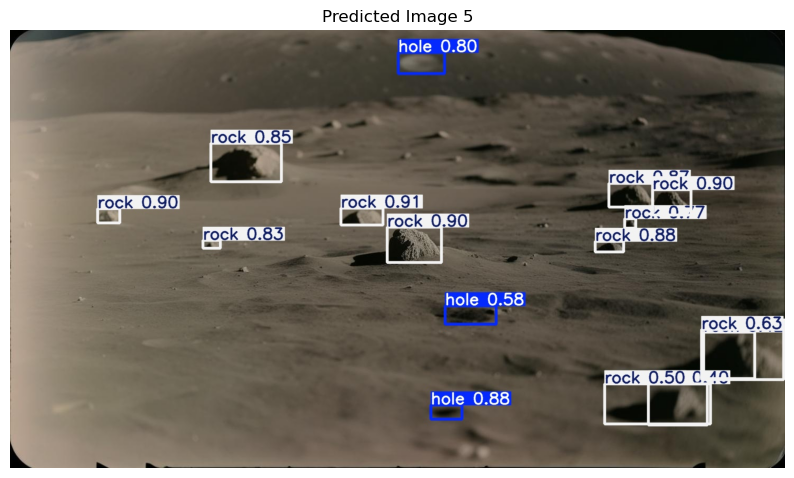

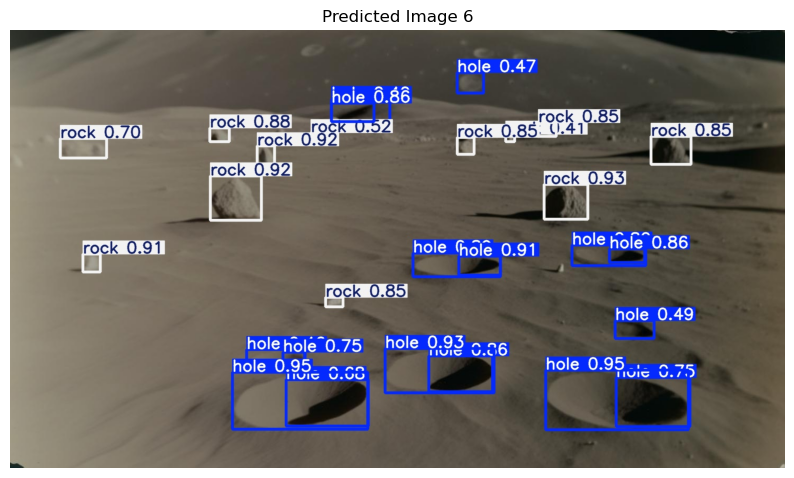

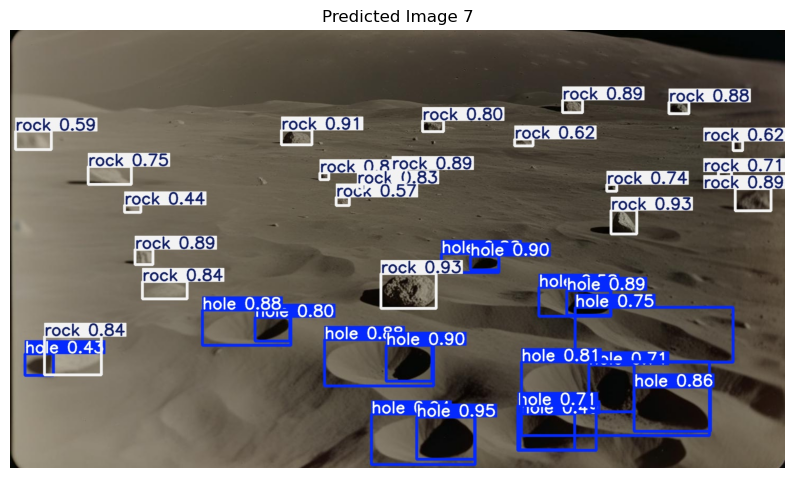

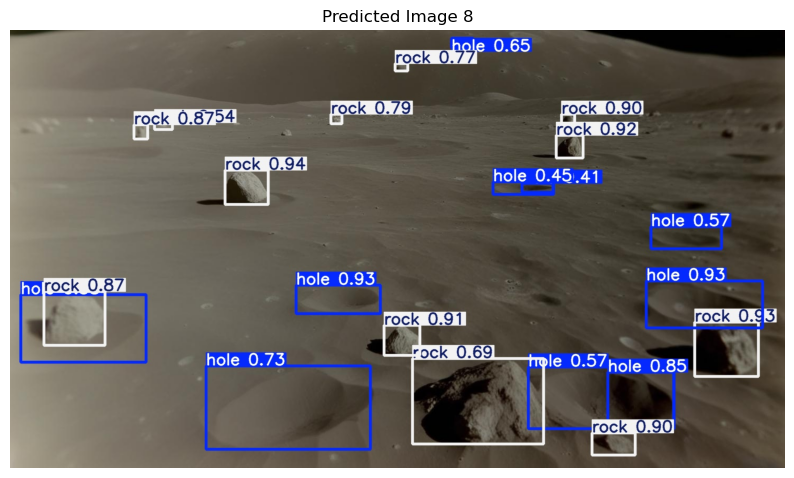

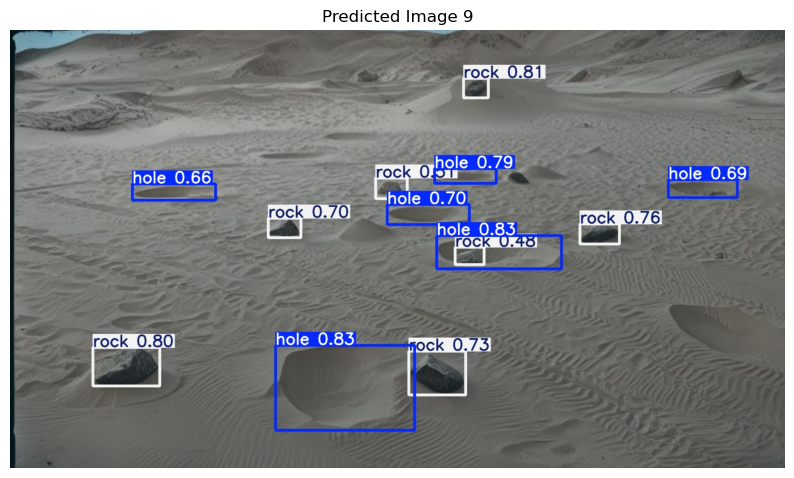

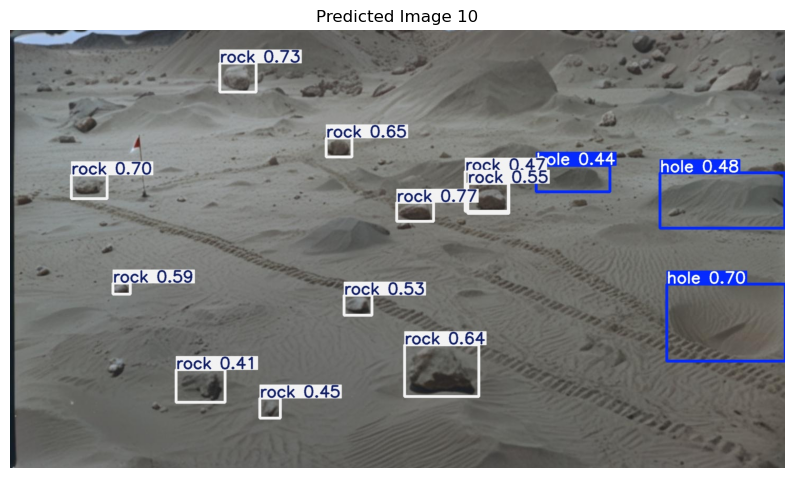

In [18]:
#lets analyze our models performance on images
import matplotlib.pyplot as plt
from PIL import Image
import glob
%matplotlib inline
import matplotlib.pyplot as plt


# Path to the directory where predictions are saved
predicted_images_dir = "runs/detect/predict19"  # Adjust as needed

# Get all predicted image paths
predicted_images = glob.glob(f"{predicted_images_dir}/*.jpg")

# Display the images using the testing set
for i, image_path in enumerate(predicted_images[:]):
    img = Image.open(image_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Predicted Image {i+1}")
    plt.show()


In [14]:
# Run predictions on the validation set
model.predict(
    source="/Users/Spenc/yoloV11/dataset/valid/images",
    imgsz=640,
    conf=0.40,
    save=True
)


image 1/40 C:\Users\Spenc\yoloV11\dataset\valid\images\Leonardo_Phoenix_Photo_of_brushed_sand_mostly_flat_ground_but_1-2-_jpg.rf.df14423f8830753069d0661c947ac813.jpg: 384x640 8 holes, 9 rocks, 259.5ms
image 2/40 C:\Users\Spenc\yoloV11\dataset\valid\images\Leonardo_Phoenix_Photo_of_brushed_sand_mostly_flat_ground_but_2-4_jpg.rf.dd6a79df7f0e6add70920d6bcbde75c0.jpg: 384x640 1 hole, 11 rocks, 4.6ms
image 3/40 C:\Users\Spenc\yoloV11\dataset\valid\images\Leonardo_Phoenix_Photo_of_brushed_sand_mostly_flat_ground_but_3-2_jpg.rf.7be50e4005845f0a477918bf90560c09.jpg: 384x640 1 hole, 16 rocks, 3.6ms
image 4/40 C:\Users\Spenc\yoloV11\dataset\valid\images\Leonardo_Phoenix_Photo_of_brushed_sand_mostly_flat_ground_but_3_jpg.rf.8ba2c5dfa445dec76fce0c773c940a7d.jpg: 384x640 1 hole, 9 rocks, 15.4ms
image 5/40 C:\Users\Spenc\yoloV11\dataset\valid\images\Leonardo_Vision_XL_Photo_of_brushed_sand_mostly_flat_ground_bu_2_jpg.rf.b76c6db1e29263755cf3c4ea8d894a87.jpg: 384x640 2 holes, 1 rock, 3.9ms
image 6/40

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'hole', 1: 'r-', 2: 'rock'}
 obb: None
 orig_img: array([[[76, 79, 70],
         [76, 79, 70],
         [77, 80, 71],
         ...,
         [42, 37, 22],
         [42, 37, 22],
         [42, 37, 22]],
 
        [[70, 73, 64],
         [70, 73, 64],
         [71, 74, 65],
         ...,
         [42, 37, 22],
         [42, 37, 22],
         [42, 37, 22]],
 
        [[72, 75, 66],
         [72, 75, 66],
         [73, 76, 67],
         ...,
         [42, 37, 22],
         [42, 37, 22],
         [42, 37, 22]],
 
        ...,
 
        [[69, 69, 57],
         [71, 71, 59],
         [73, 73, 61],
         ...,
         [37, 31, 18],
         [38, 32, 19],
         [38, 32, 19]],
 
        [[71, 71, 59],
         [72, 72, 60],
         [75, 75, 63],
         ...,
         [36, 30, 17],
         [37, 32, 17],
         [37, 32, 17]],
 
        [

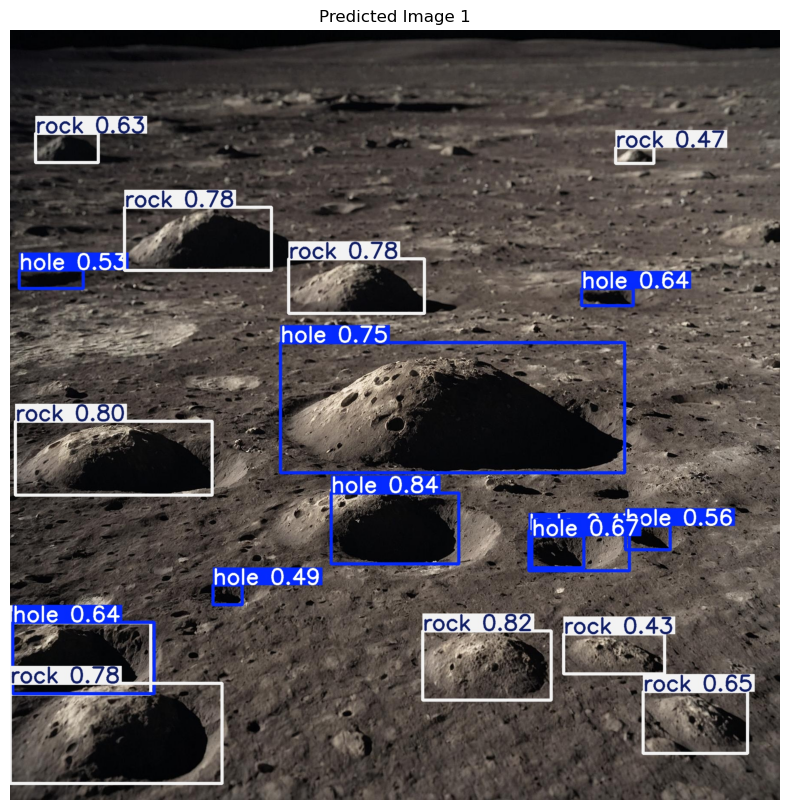

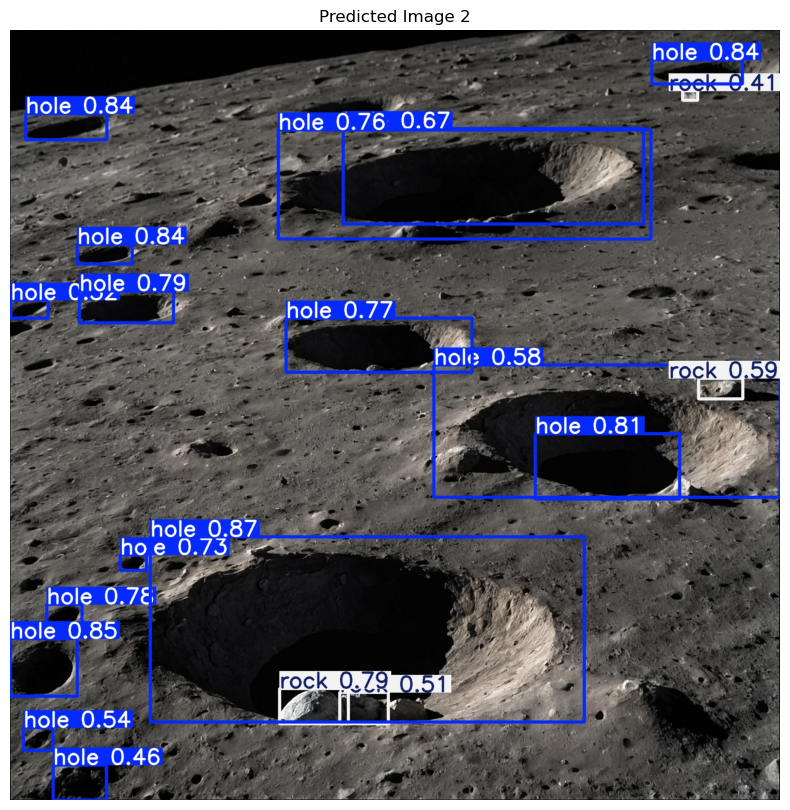

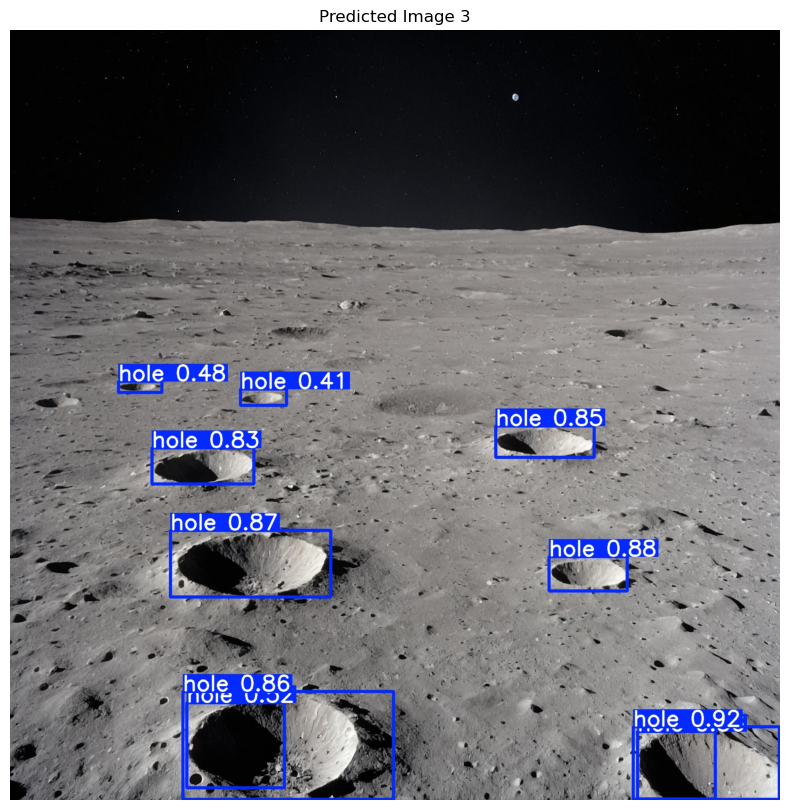

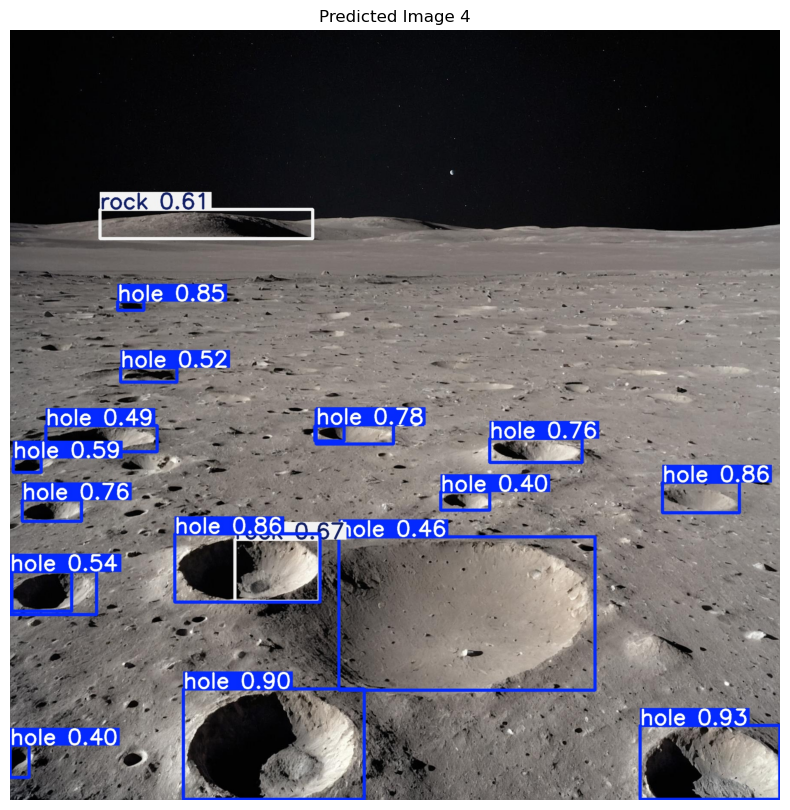

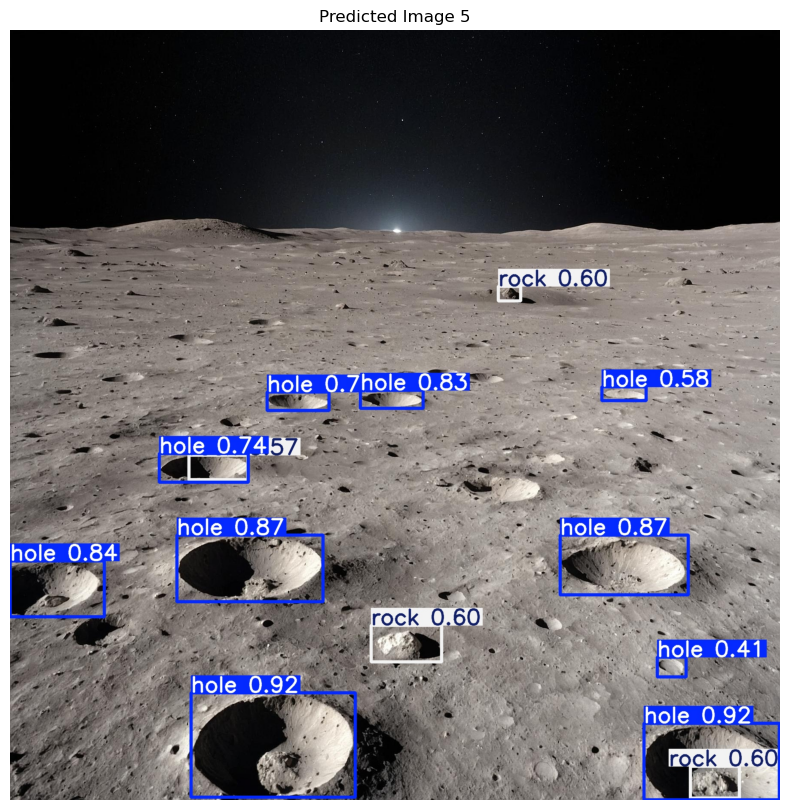

...

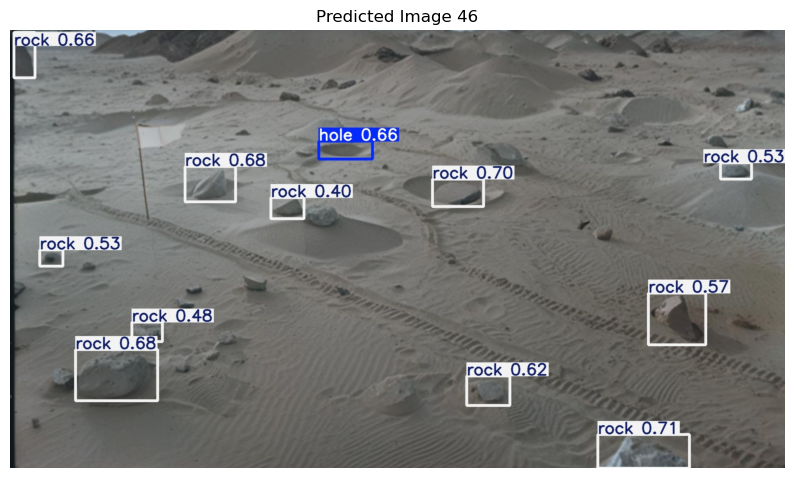

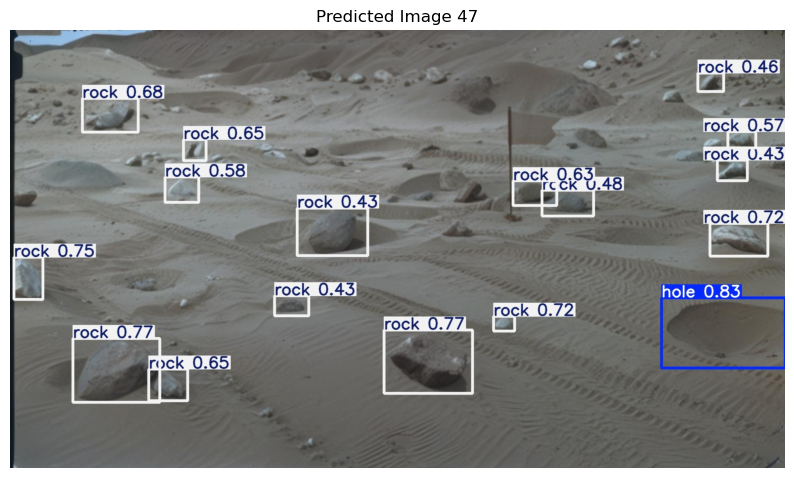

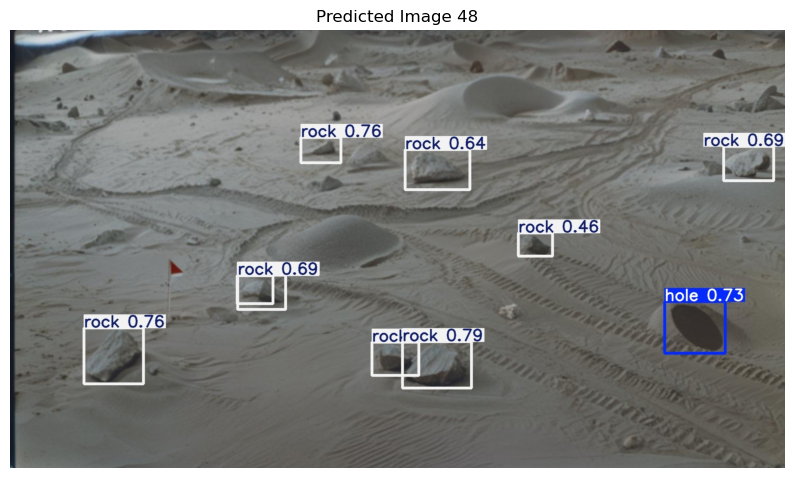

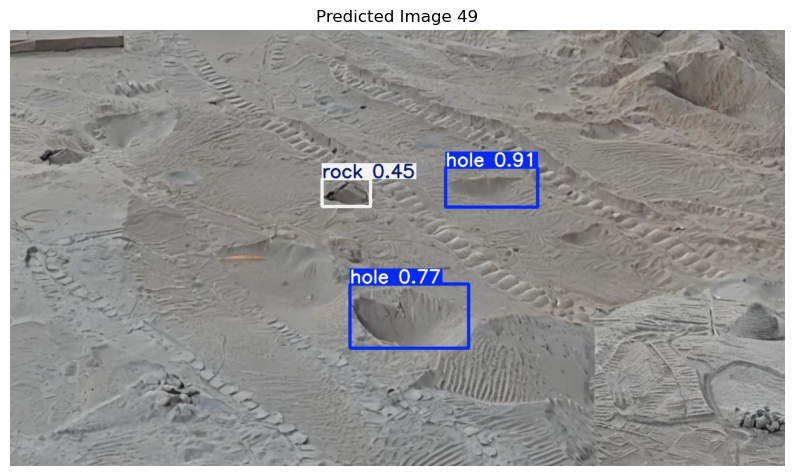

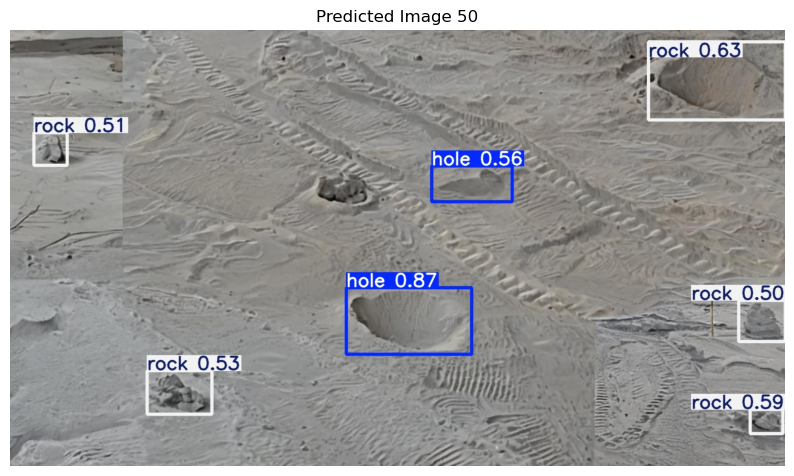

In [19]:
import matplotlib.pyplot as plt
from PIL import Image
import glob
%matplotlib inline
import matplotlib.pyplot as plt


# Path to the directory where predictions are saved
predicted_images_dir = "runs/detect/predict18"  # Adjust as needed

# Get all predicted image paths
predicted_images = glob.glob(f"{predicted_images_dir}/*.jpg")

# Display the images using the validation set
for i, image_path in enumerate(predicted_images[:]):
    img = Image.open(image_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Predicted Image {i+1}")
    plt.show()


In [17]:

# Evaluate on the test set
metrics = model.val(
    data="/Users/Spenc/yoloV11/dataset/data.yaml",
    split="test",
    imgsz=640,
    batch=16
)

Ultralytics 8.3.38  Python-3.10.14 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)


val: Scanning C:\Users\Spenc\yoloV11\dataset\test\labels.cache... 10 images, 0 backgrounds, 0 corrupt: 100%|██████████|
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<0


                   all         10        267      0.796      0.707      0.799      0.597
                  hole         10        100      0.779      0.636      0.747      0.545
                  rock         10        167      0.812      0.778      0.851      0.648
Speed: 0.2ms preprocess, 25.5ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\val3


In [18]:
# Extract metrics
precision = metrics.box.p   # Precision (numpy.ndarray)
recall = metrics.box.r      # Recall (numpy.ndarray)
map_50 = metrics.box.map50  # mAP@0.5 (scalar or array)
map_50_95 = metrics.box.map  # mAP@0.5:0.95 (scalar or array)

# Compute overall metrics
overall_precision = precision.mean()
overall_recall = recall.mean()

# Print overall metrics
print(f"Overall Precision: {overall_precision:.3f}")
print(f"Overall Recall: {overall_recall:.3f}")




Overall Precision: 0.796
Overall Recall: 0.707
